In [2]:
%load_ext autoreload
%autoreload 2
import feature_extract
import sys
sys.path.append("..")
import torch
import psql_methods as psql
import pickle
import alchemy_methods as alc
from tqdm import tqdm
import numpy as np
import image_utils as imgs
import opensea_methods as opse
import multiprocessing
import pandas as pd
import feature_utils as feat
import matplotlib.pyplot as plt
import counterfeit_utils as cfu

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
# subjective_cf_num: slug: VARCHAR 255, counterfeit_num: INTEGER, type: VARCHAR 255

# Counterfeit

In [ ]:
f = open('top_100_pfps.txt','r')
pfps = list(f)
pfps = [x.strip('\n') for x in pfps]

In [3]:
# completed_slugs = [slug[0] for slug in cfu.get_counterfeit_db()]
# remaining_slugs = [slug for slug in slugs if not slug in completed_slugs]
# len(remaining_slugs)

65

lilpudgys
Overlap slugs: ['cabu-cats', 'fortune-friends-club-official-nft', 'dank-ducks-nft', 'babyghosts', 'smolmoe', 'pudgypenguins', 'rare-panthers', 'thealiendoogle', 'bubblefriends-nft', 'coolapeclubofficial', 'sugartownoras', 'binkie-babies', 'pudgy-penguins-girls', 'nuclear-rejects', 'party-penguins', 'chill-princesses', 'skell-yeah', 'thepppandas', 'hoodles-official', 'foxyfamnft', 'baycclubnft', 'pudgy-azurbala', 'stakedseals', 'jukisammy', 'doodle-dood-nfts', 'zoofrenz-apefrenz-2-0', 'sweetpalss', 'retrooootown', '0xdoodlesnft', 'zombie-penguins', 'coolpenguinswtf', 'imaginaries-2', 'schrtdingers-cat-nft', 'sweetiesnftofficial', 'okcnp', 'we-are-flowers', 'cyberducksevolution', 'sappy-seals', 'gutter-punks', 'kawaii-plushies-2', 'dippies', 'bitcoinbeanz', 'feelgang', 'shibadoodles', 'doodles-official', 'iamslothnft', 'chumchumsnft', 'kumo-x-world-residents', 'groovy-doodles', 'konneecheewahs', 'trekkinftofficial', 'chubbykaijudao', 'sappypenguinsnft', 'lambduhs', 'turtletown'

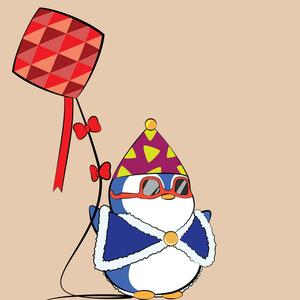

cabu-cats 1


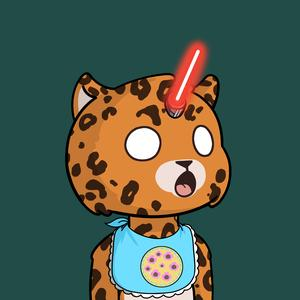

fortune-friends-club-official-nft 2


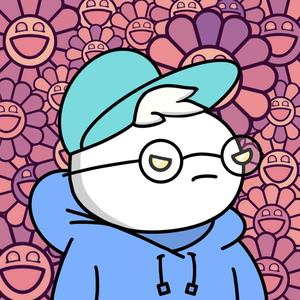

dank-ducks-nft 3


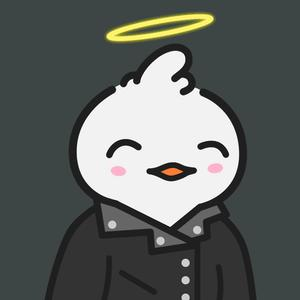

babyghosts 4


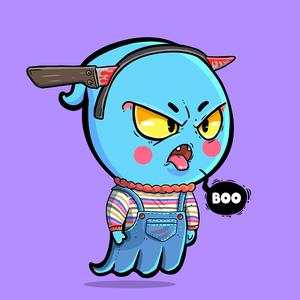

smolmoe 5


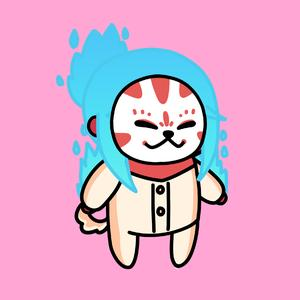

pudgypenguins 6


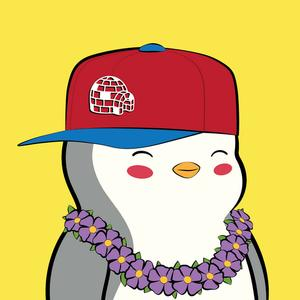

rare-panthers 7


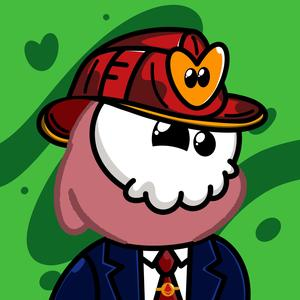

thealiendoogle 8


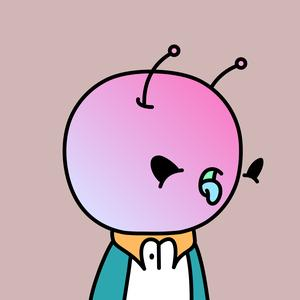

bubblefriends-nft 9


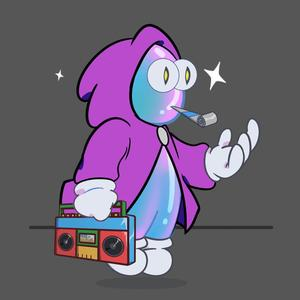

coolapeclubofficial 10


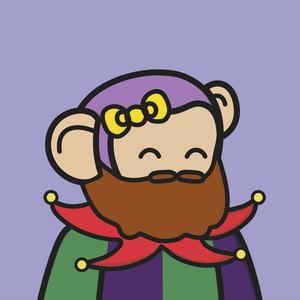

sugartownoras 11


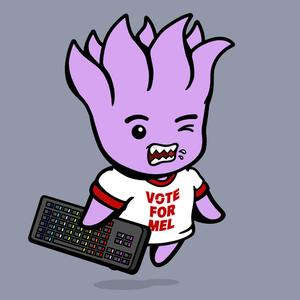

binkie-babies 12


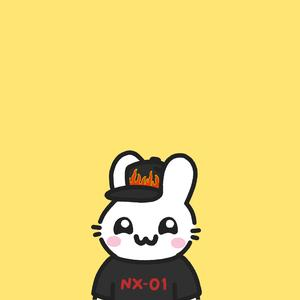

pudgy-penguins-girls 13


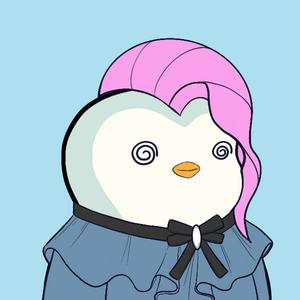

nuclear-rejects 14


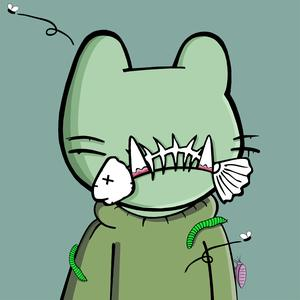

party-penguins 15


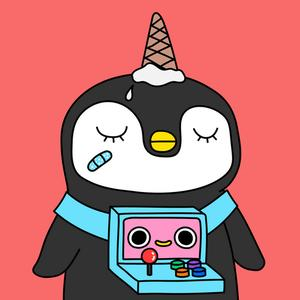

chill-princesses 16


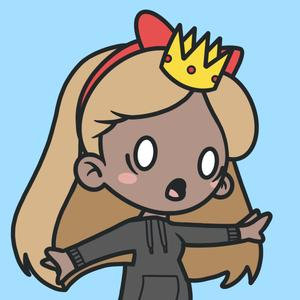

skell-yeah 17


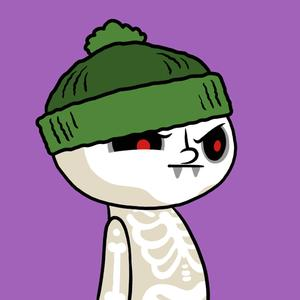

thepppandas 18


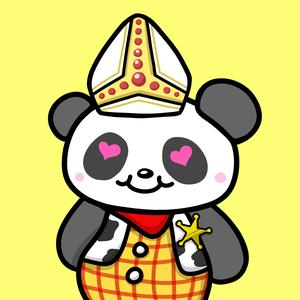

hoodles-official 19


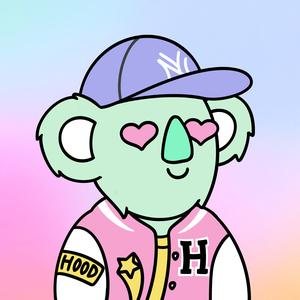

foxyfamnft 20


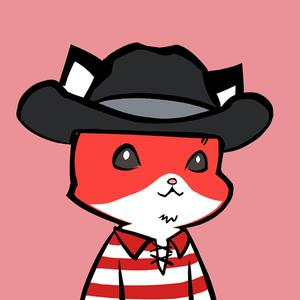

baycclubnft 21


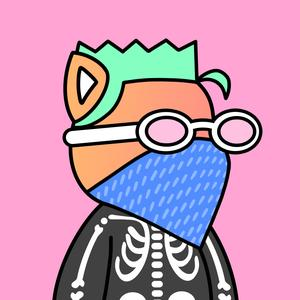

pudgy-azurbala 22


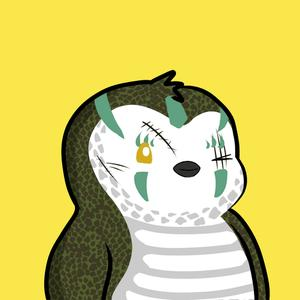

stakedseals 23


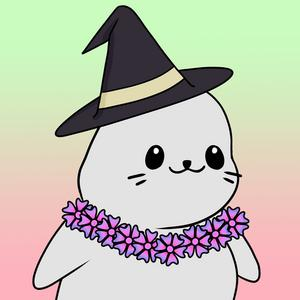

jukisammy 24


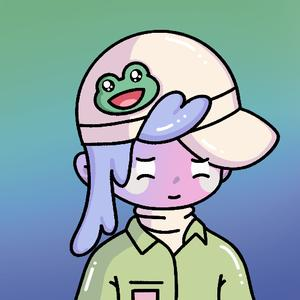

doodle-dood-nfts 25


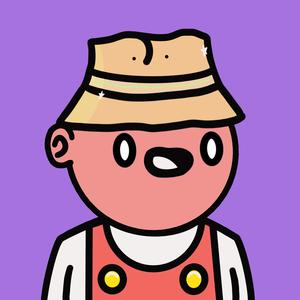

zoofrenz-apefrenz-2-0 26


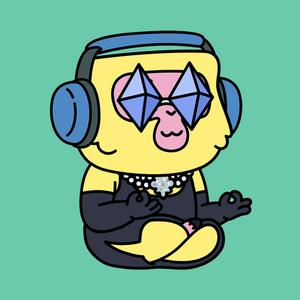

sweetpalss 27


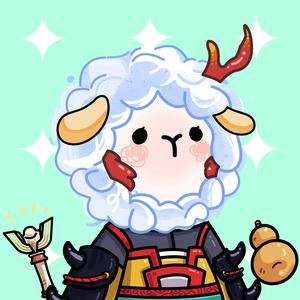

retrooootown 28


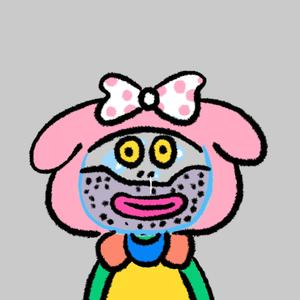

0xdoodlesnft 29


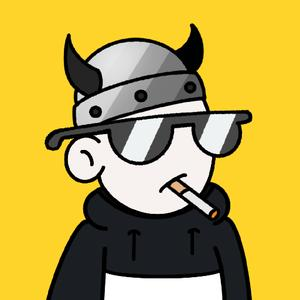

zombie-penguins 30


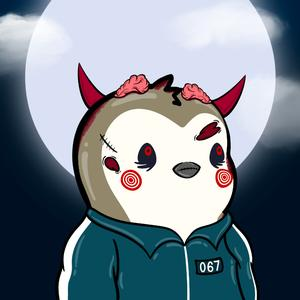

coolpenguinswtf 31


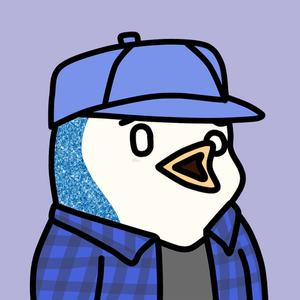

imaginaries-2 32


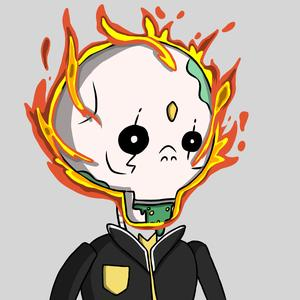

schrtdingers-cat-nft 33


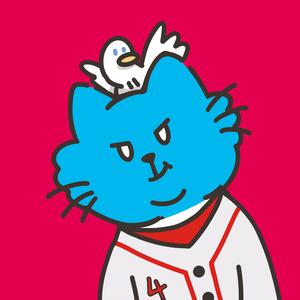

sweetiesnftofficial 34


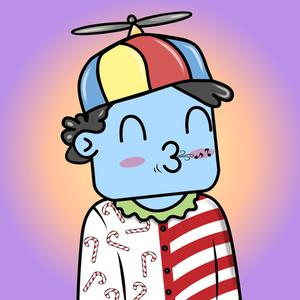

okcnp 35


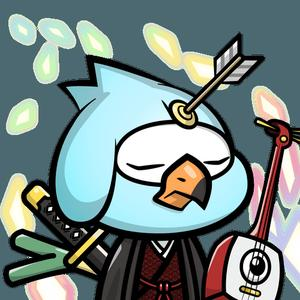

we-are-flowers 36


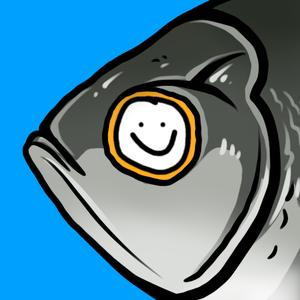

cyberducksevolution 37


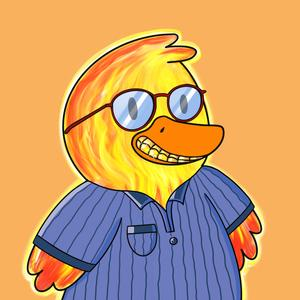

sappy-seals 38


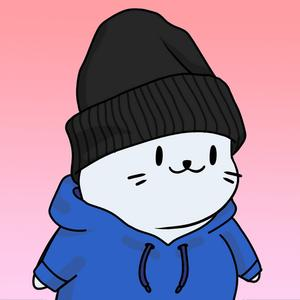

gutter-punks 39


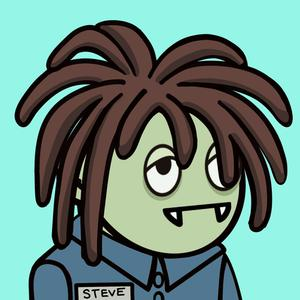

kawaii-plushies-2 40


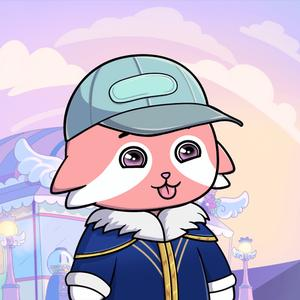

dippies 41


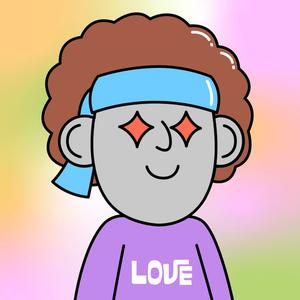

bitcoinbeanz 42


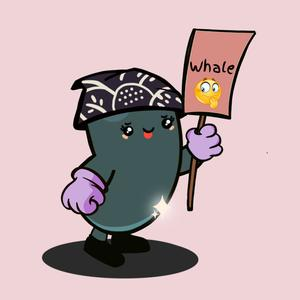

feelgang 43


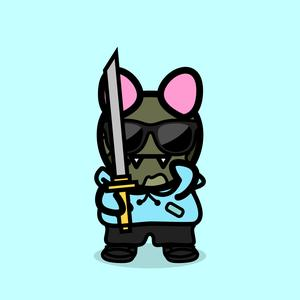

shibadoodles 44


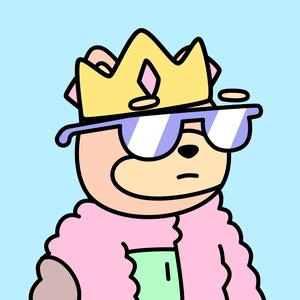

doodles-official 45


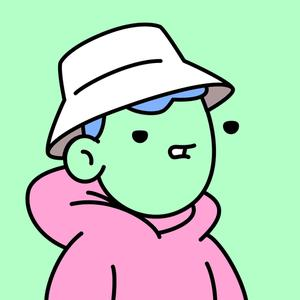

iamslothnft 46


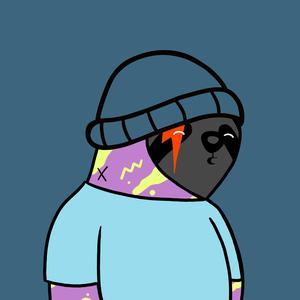

chumchumsnft 47


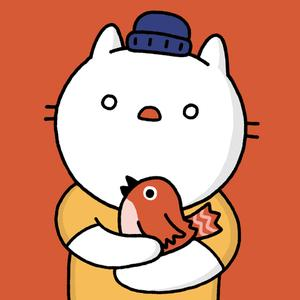

kumo-x-world-residents 48


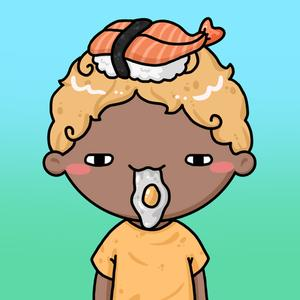

groovy-doodles 49


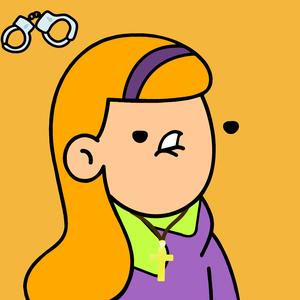

konneecheewahs 50


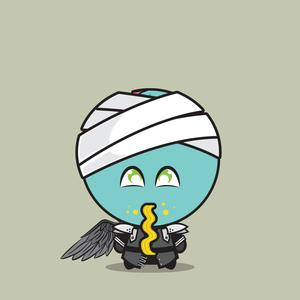

trekkinftofficial 51


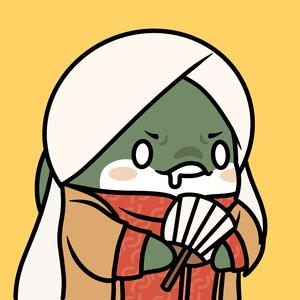

chubbykaijudao 52


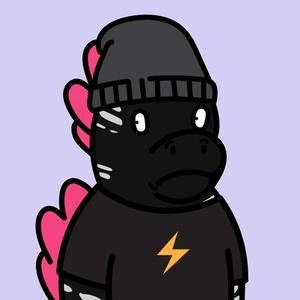

sappypenguinsnft 53


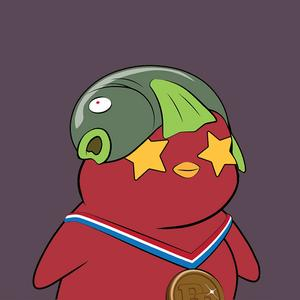

lambduhs 54


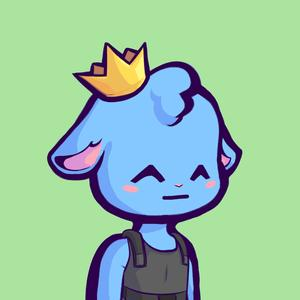

turtletown 55


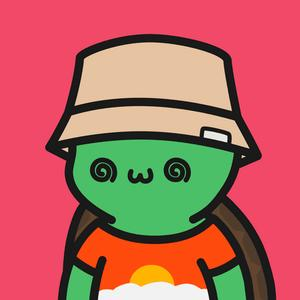

lfg-meep 56


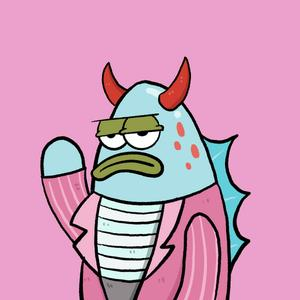

cat-civilization 57


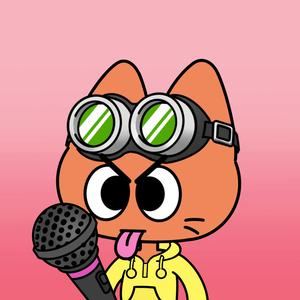

babobunnyclub 58


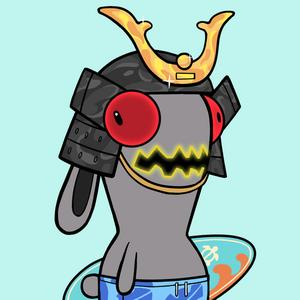

small-graffiti 59


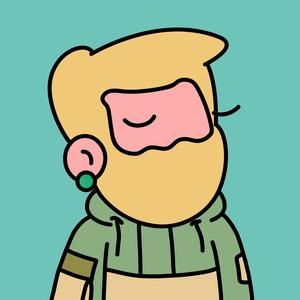

coconutznftofficial 60


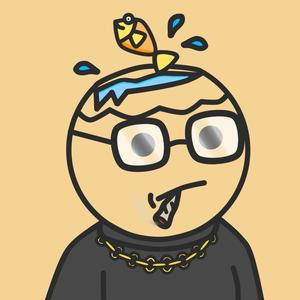

the-moonkysnft 61


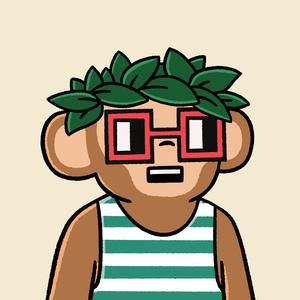

cnpj-v2 62


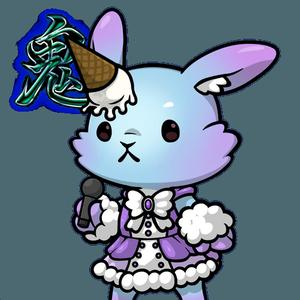

frootiez 63


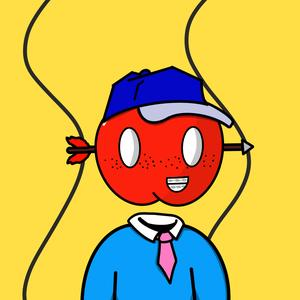

coolboysofficial 64


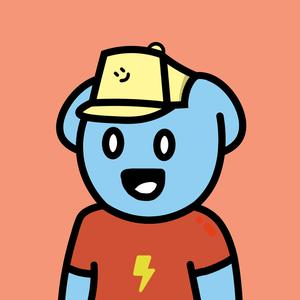

app-grg 65


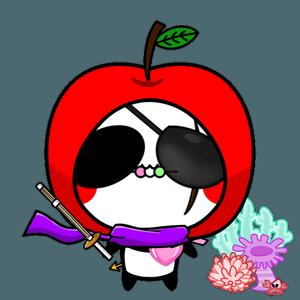

pudgy-gobblers 66


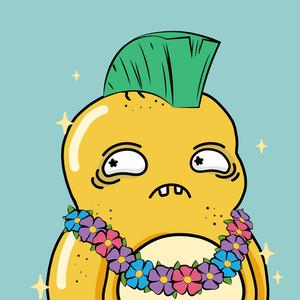

the-chimpsons-pets 67


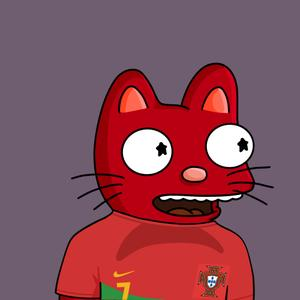

the-scornables 68


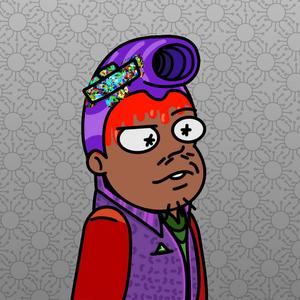

pudgy-pandas-official 69


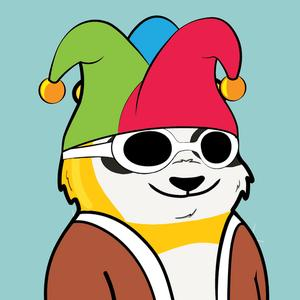

spacecrocos 70


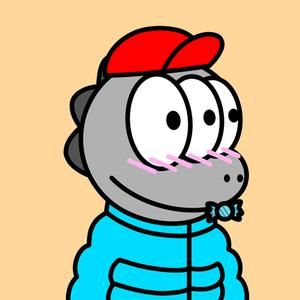

meepsofficial 71


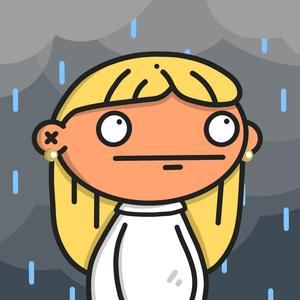

frnds-club 72


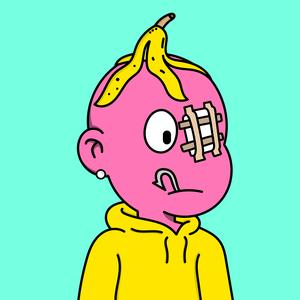

doodleduckling-official 73


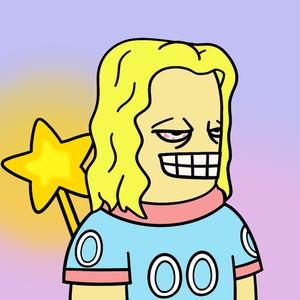

oh-ottie 74


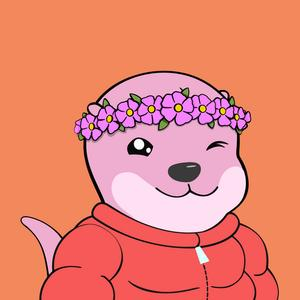

momoape-club 75


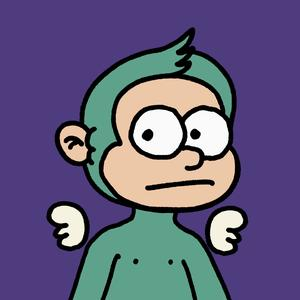

cozy-penguin 76


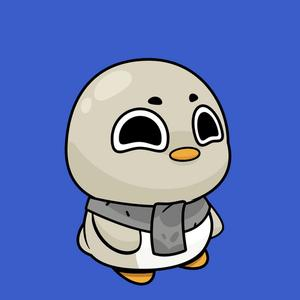

krazykoalas 77


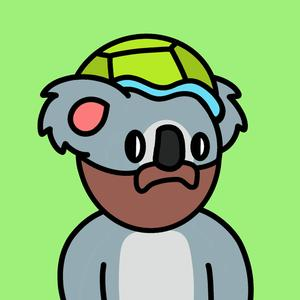

little-lemon-friends 78


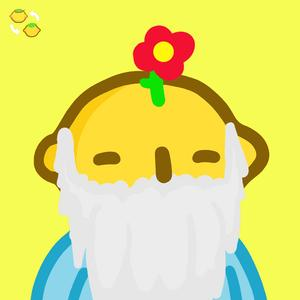

frenly-flyz 79


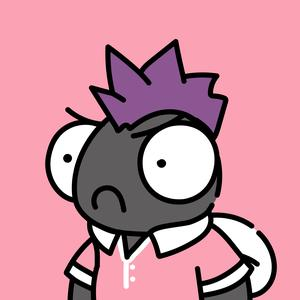

mocaverse 80


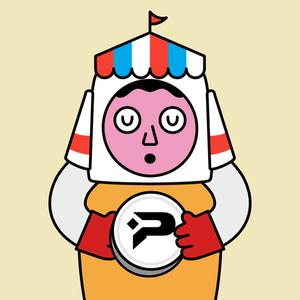

hitodumadao-cnpbaby 81


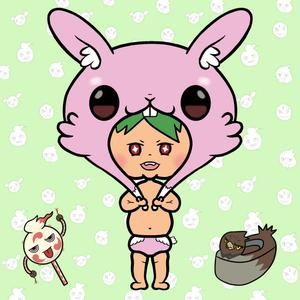

fairyfiends 82


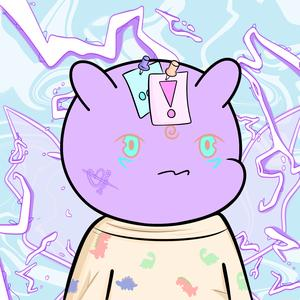

cryptoninjapartners-v2 83


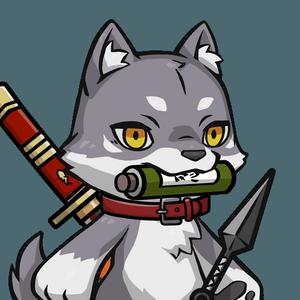

drunk-ass-dinos 84


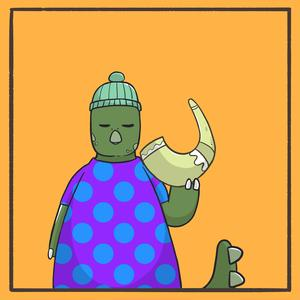

owange-yacht-club 85


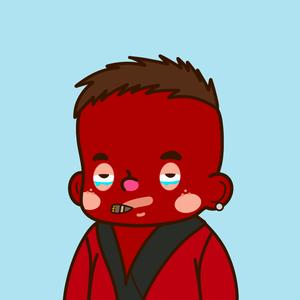

boobunchnft 86


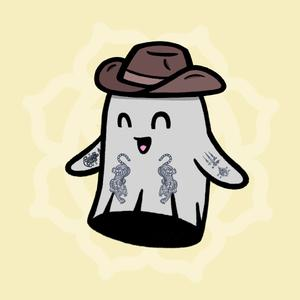

elfooznfts 87


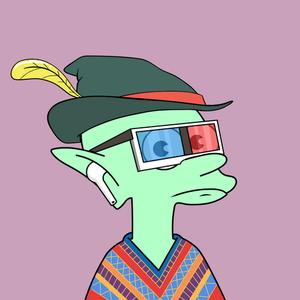

chubbyanxiety 88


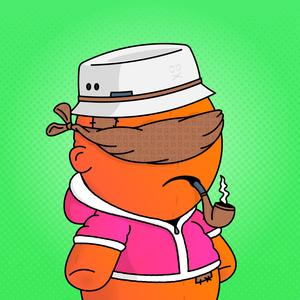

meteorianft-mto 89


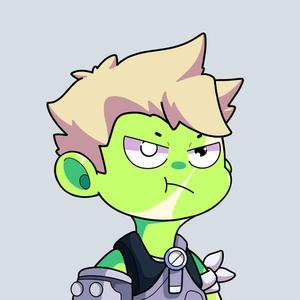

feet-and-eyes-guys 90


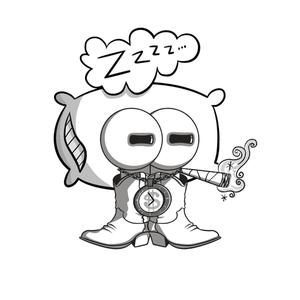

the-weirdos-battle-royale 91


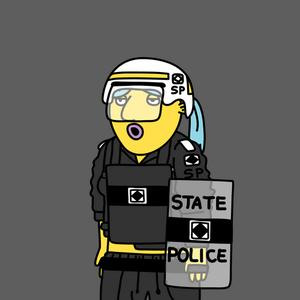

mobs-and-aliens 92


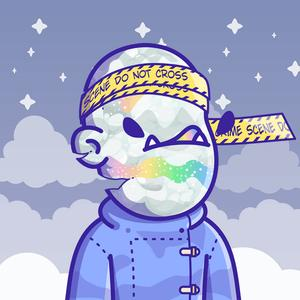

moshimochi 93


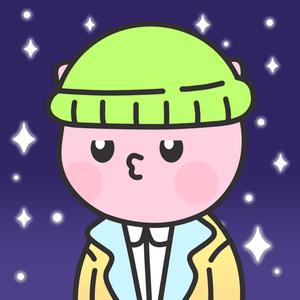

mylilgnomienft 94


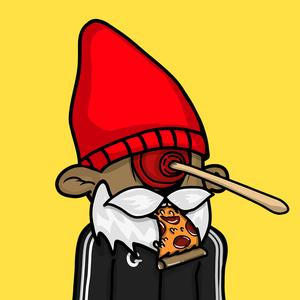

hellobotuniverseofficial 95


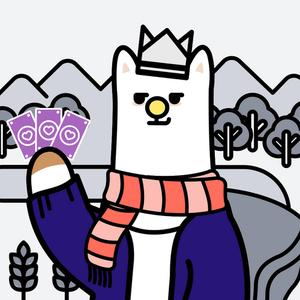

cnp-students 96


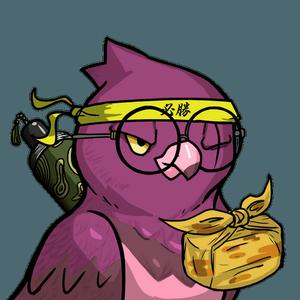

kanpai-pandas 97


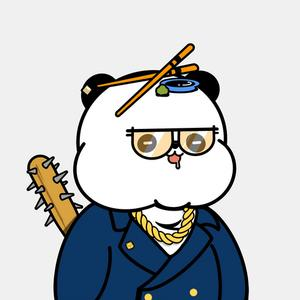

nickelodeon-eth 98


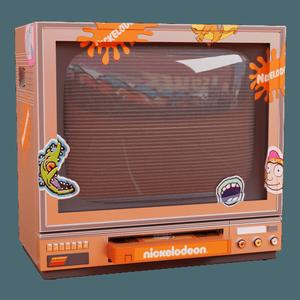

derplife 99


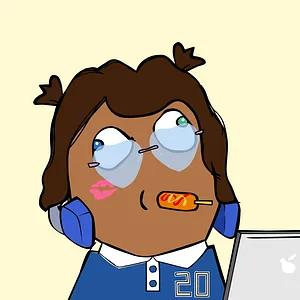

squishy-squad 100


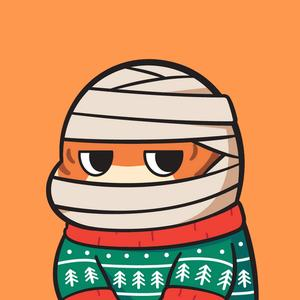

boringone 101


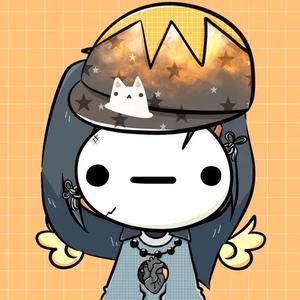

toyboogers 102


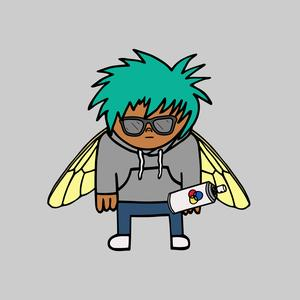

larva-doods 103


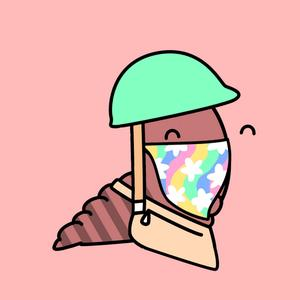

iscreamstory 104


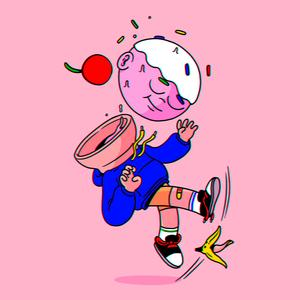

bunny-belly-club-v2 105


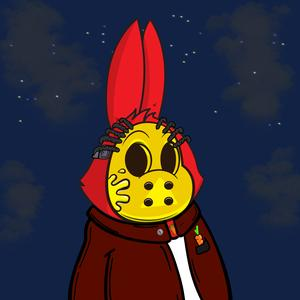

lilgoatgang 106


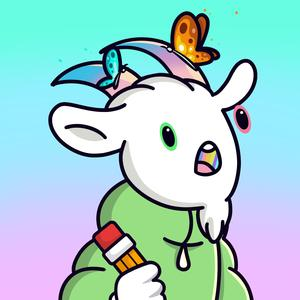

pepe-booty 107


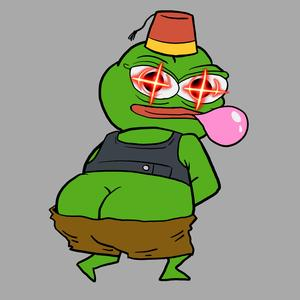

sealzzz 108


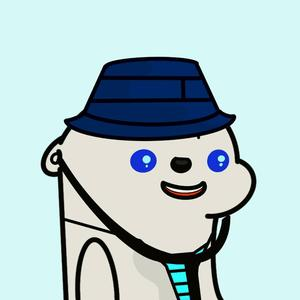

crashtestjoyride 109


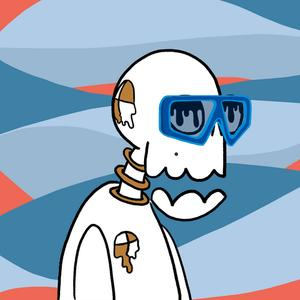

odenpets 110


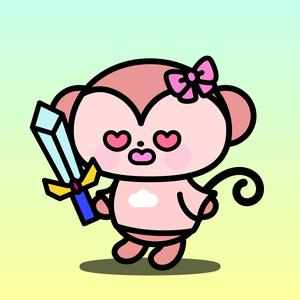

oot-origins 111


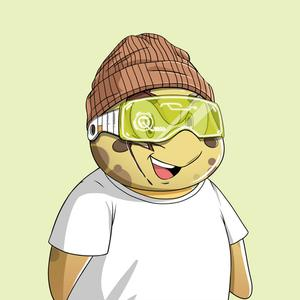

forever-fomo-duck-squad 112


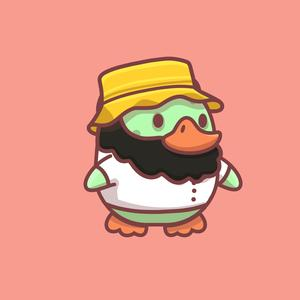

lilbrains 113


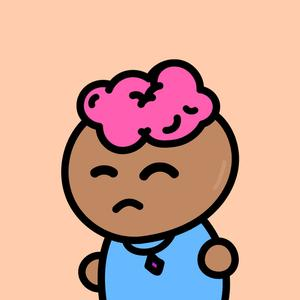

noevilmonkeysnft 114


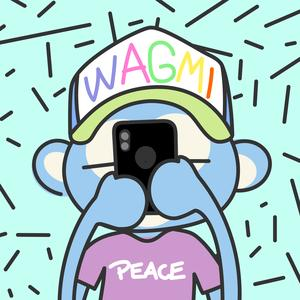

dopeysnft 115


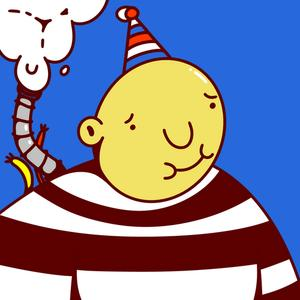

wrapped-frosties 116


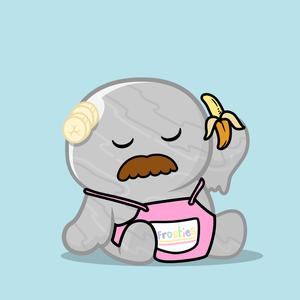

gnomepals 117


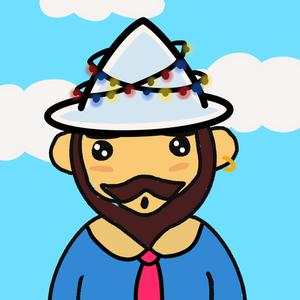

riotgirls 118


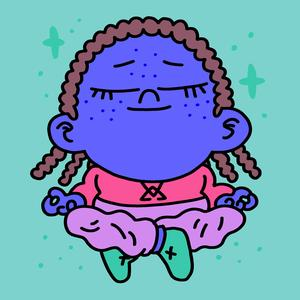

indigochild 119


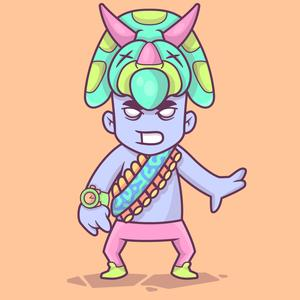

chubbylittlejiras 120


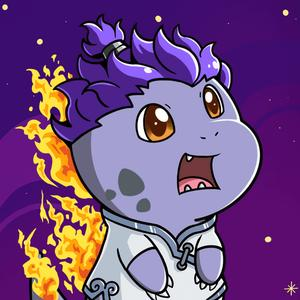

deggenz 121


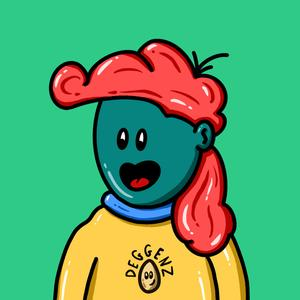

sappy-seal-yacht-club 122


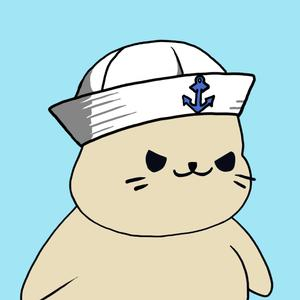

wonderpals 123


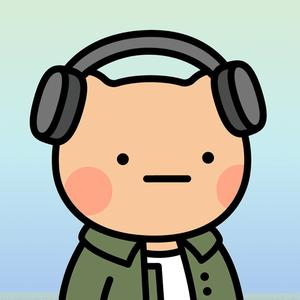

familiarstudios 124


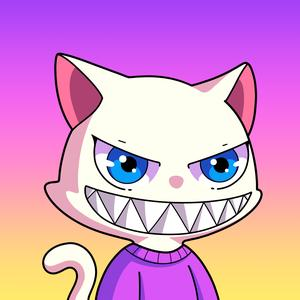

smiliesgenesis 125


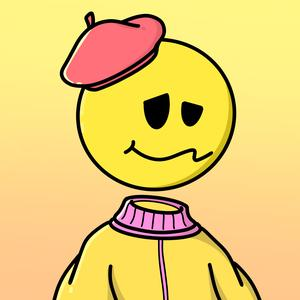

stranger-eggz 126


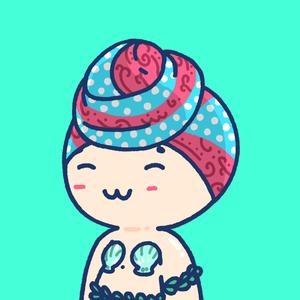

beepos 127


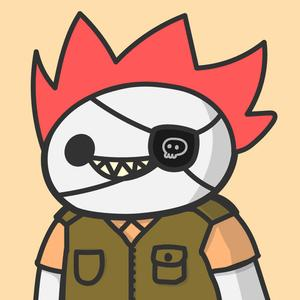

lilbabyalienfrens 128


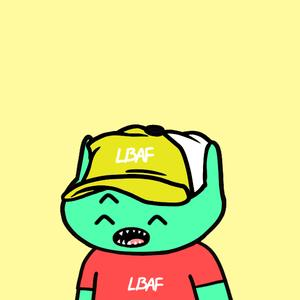

grimmies-by-webacy 129


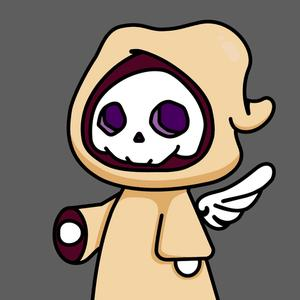

halfkingz 130


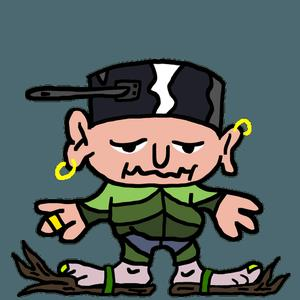

pudgy-karma 131


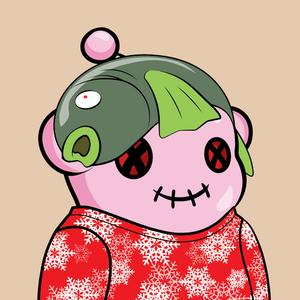

thebeeings 132


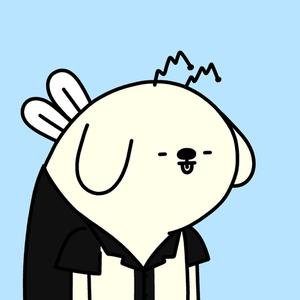

buddabearsofficial 133


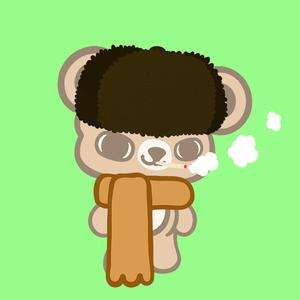

dead-devil-society 134


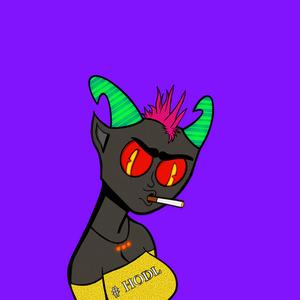

braqfrnds 135


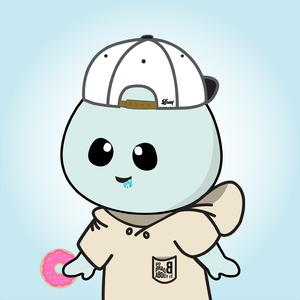

blubea-nft-official 136


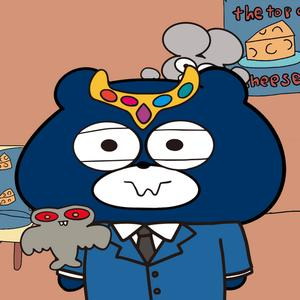

wearetoysterz-official 137


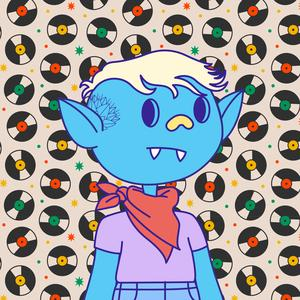

chubbykaijudaoinvasion 138


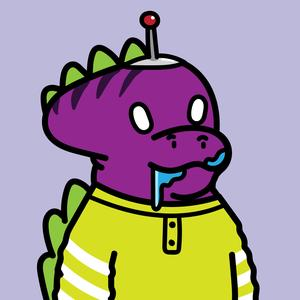

ferals 139


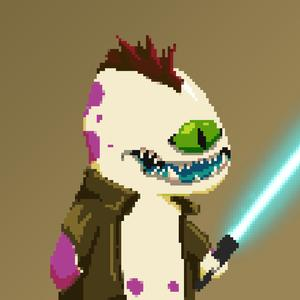

strange-times- 140


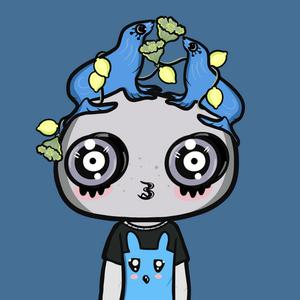

boss-bunnies-nft-official 141


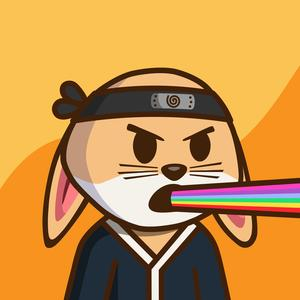

poor-rich-boys 142


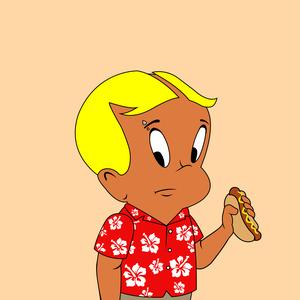

beanbagfrens-nft 143


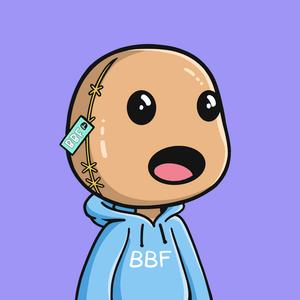

chill-frogs 144


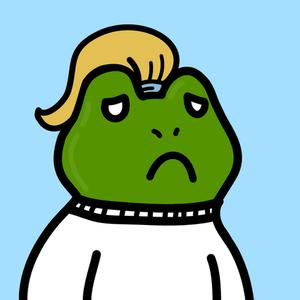

partysheepclub 145


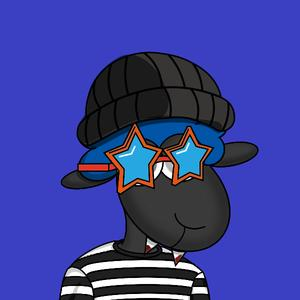

cheeks-pepo 146


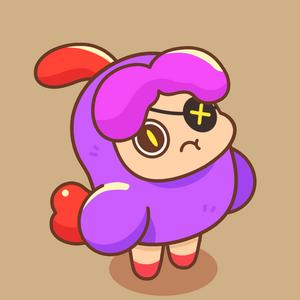

we-the-kids 147


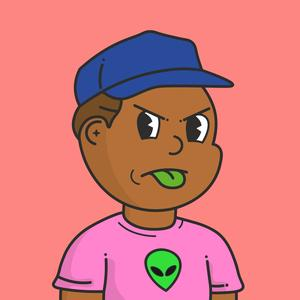

penguinspixelworld 148


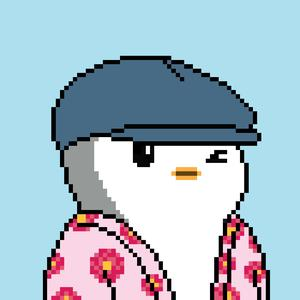

cnp-philippines-happydaoyarou 149


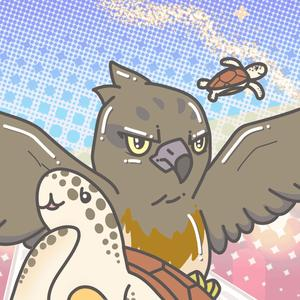

coolmans-universe 150


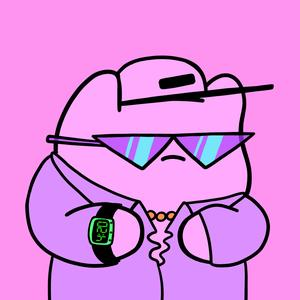

coodles 151


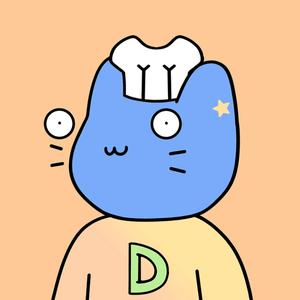

baby-apes-origins 152


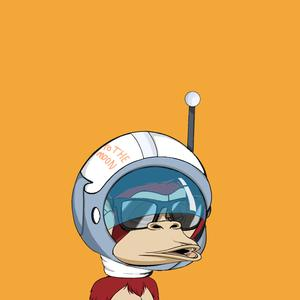

baddiesofficial 153


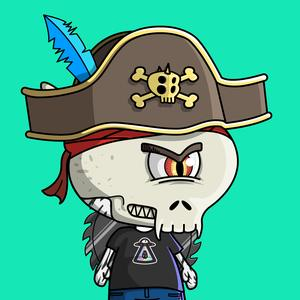

axolittles 154


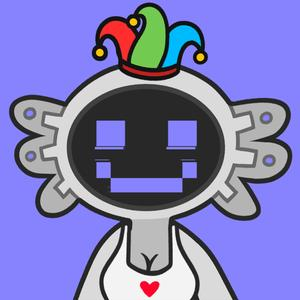

littlepeckers 155


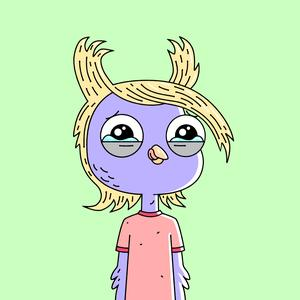

mirakai-heroes 156


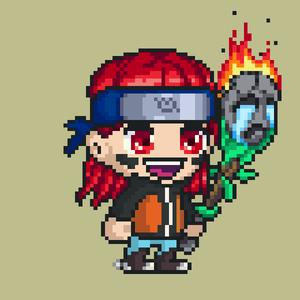

poshpandas 157


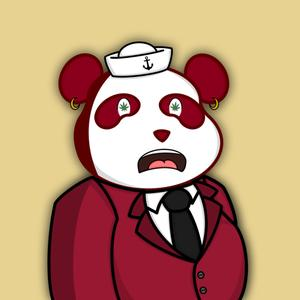

kekversebybasedpleb 158


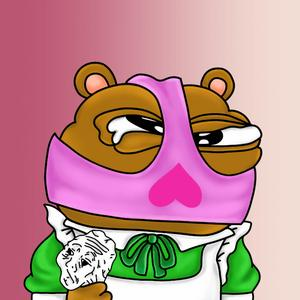

semisupersofficial 159


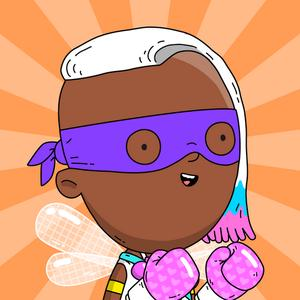

baby-duck-pond 160


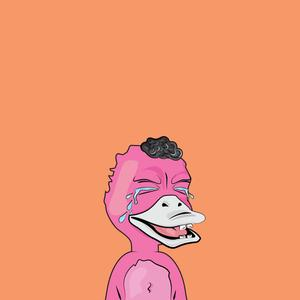

lofikitties 161


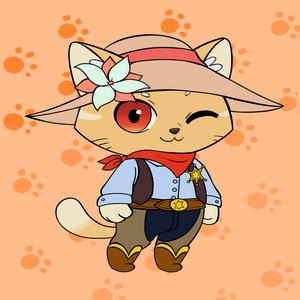

doodledogsofficial 162


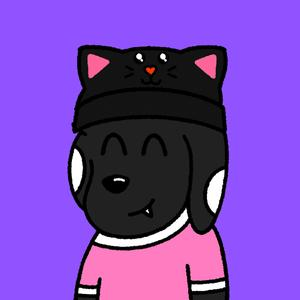

gummiesgang-official 163


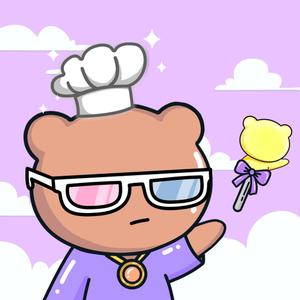

cnp-reborn-nft-for-all-generations-to-enjoy 164


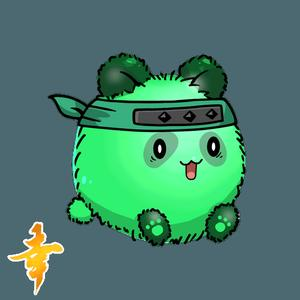

official-droplets 165


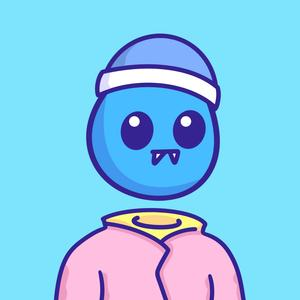

lucid-official 166


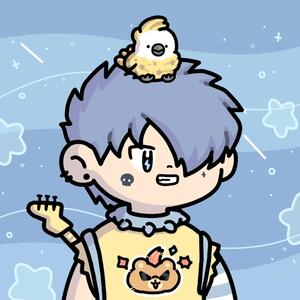

inbetweeners 167


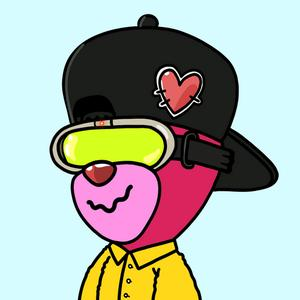

boring-frog-v2 168


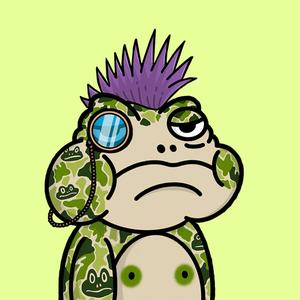

ghost-buddy 169


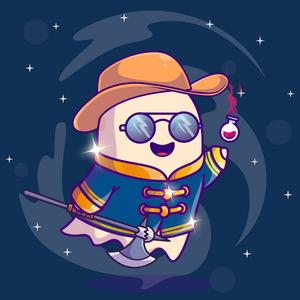

meemosworld 170


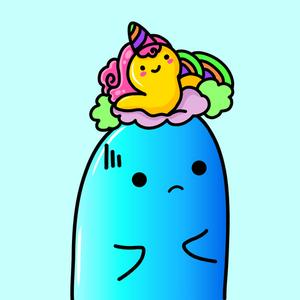

thesaudisgoblin 171


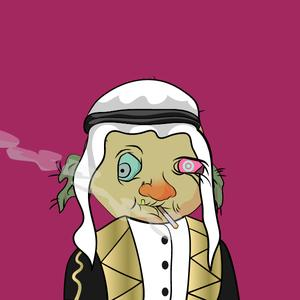

metaflexer 172


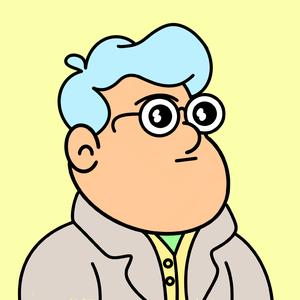

mfn-gutter-punks 173


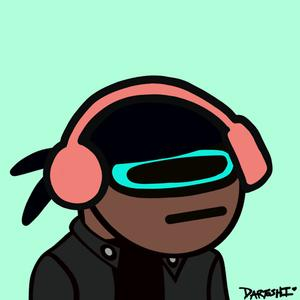

cool-cats-nft 174


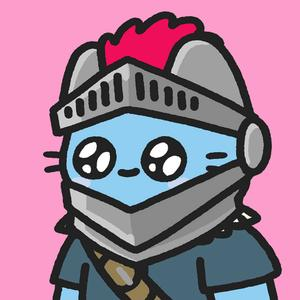

phantadoodles 175


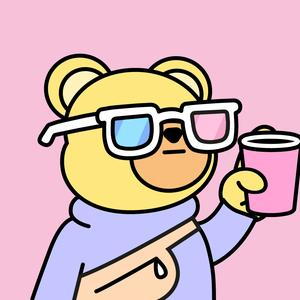

whaletogether 176


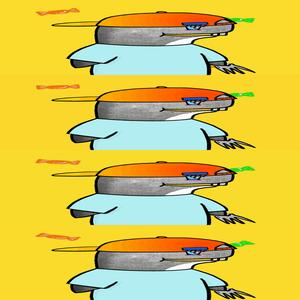

chillbearclub-genesis 177


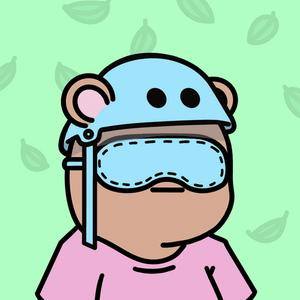

its-free-mint 178


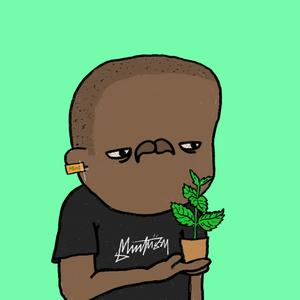

ayahuasca-cats 179


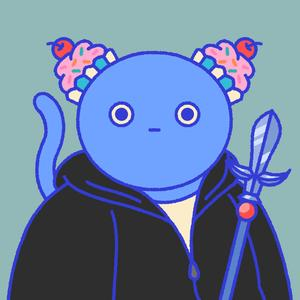

lilfarmboynft-unofficial 180


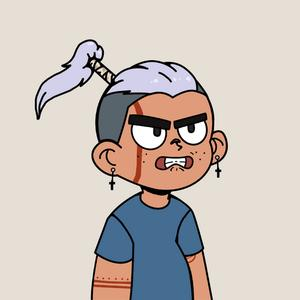

baby-elephants-squad 181


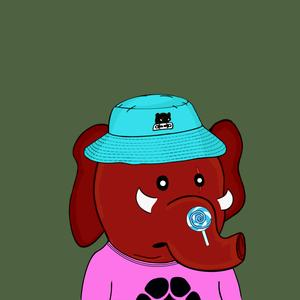

spriteclub 182


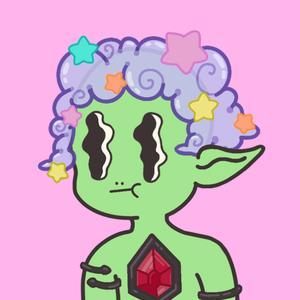

heyreap3r 183


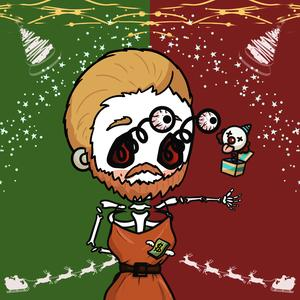

space-boo-official-nft 184


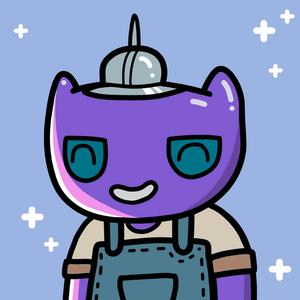

doodlespepes 185


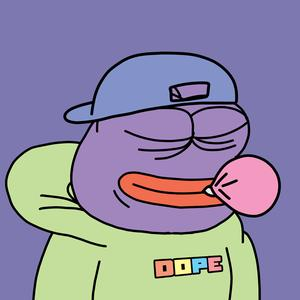

kubz 186


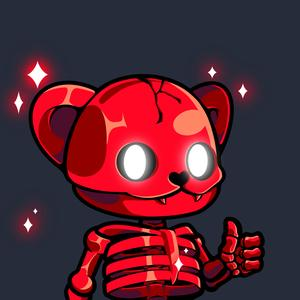

hushpuppiesnft 187


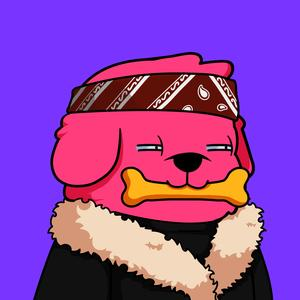

dirty-flies 188


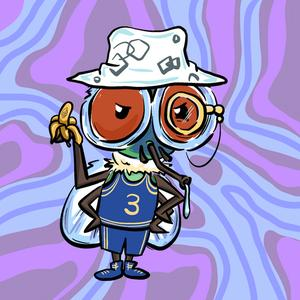

gfsdhgfd 189


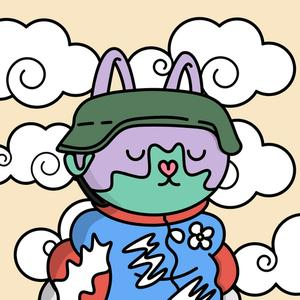

official-marrer-nft 190


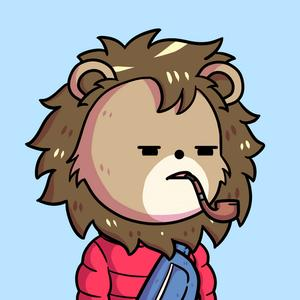

mic-wizards-the-return 191


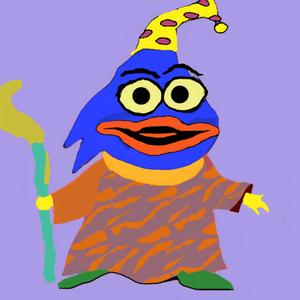

gemapeclubnft 192


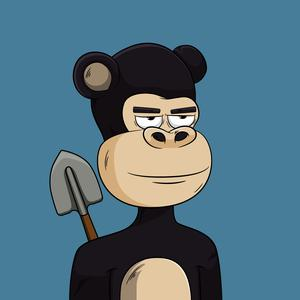

the-egg-society 193


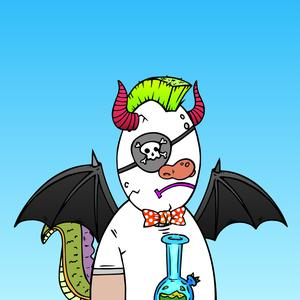

chubbiverse-frens 194


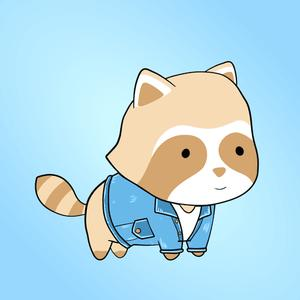

fanggangnft 195


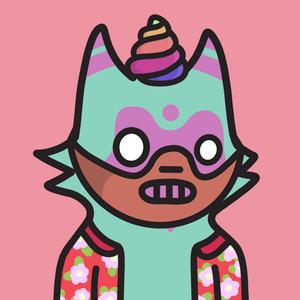

ens-pudgy-penguin 196


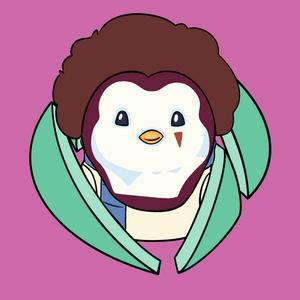

cryptomories 197


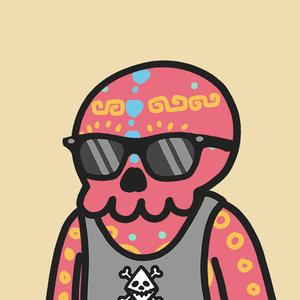

rainbowcatsnft 198


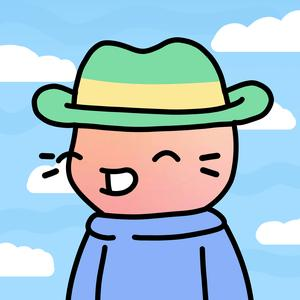

winterbears 199


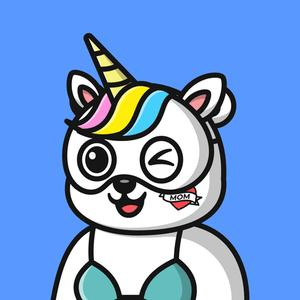

bullmarketbunniesnft 200


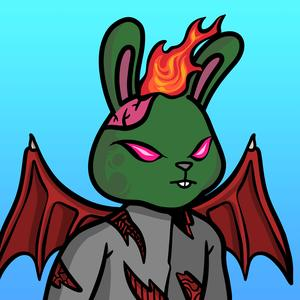

In [5]:
def show_aesthetic_similar(cur_slug, end):
    overlap_df = cfu.get_overlaps(cur_slug).groupby(['slug', 'sorted_order'])['sorted_order'].count().reset_index(name='overlap').sort_values('sorted_order')
    overlaps = sorted([tuple(x) for x in overlap_df.to_records(index=False)], key=lambda x: x[1])
    overlap_slugs = [x[0] for x in overlaps]
    print('Overlap slugs:', overlap_slugs[0:100])
    try:
        root = 'graph_images/val'
        imgs.show_random_image(root, cur_slug)
    except FileNotFoundError:
        root = 'counterfeit_images/val'
        imgs.show_random_image(root, cur_slug)
    imgs_to_show = [i for i in range(0, end)]
    for idx in imgs_to_show:
        o_slug = overlap_slugs[idx]
        print(o_slug,idx+1)
        try:
            root = 'graph_images/val'
            imgs.show_random_image(root, o_slug)
        except FileNotFoundError:
            root = 'counterfeit_images/val'
            imgs.show_random_image(root, o_slug)

current_slug_index = 30
print(pfps[current_slug_index])
show_aesthetic_similar(pfps[current_slug_index], 200)
# show_aesthetic_similar('boredapeyachtclub')

In [122]:
data = [(pfps[current_slug_index], 192, 'pfps')]
print(pfps[current_slug_index])
psql.batch_insert("INSERT INTO subjective_cf_num (slug, num, type) values (%s, %s, %s)", data)

In [73]:
psql.execute_commands(["UPDATE subjective_cf_num SET num = %s WHERE slug = %s"], [(14, pfps[current_slug_index])], no_return=True)

[('world-of-women-nft',)]

In [117]:
psql.execute_commands(["SELECT * FROM subjective_cf_num WHERE slug = %s"], [(pfps[current_slug_index],)])

[('genesis-creepz', 3, 'pfps')]

### Update counterfeit_num

In [126]:
psql.execute_commands(["UPDATE slug_to_counterfeit_num SET num = %s WHERE slug = %s"], [(192, pfps[current_slug_index])], no_return = True)

[]

In [128]:
psql.execute_commands(["UPDATE slug_to_counterfeit_num SET counterfeit_slug = %s WHERE slug = %s"], [('anonymous-punkz', pfps[current_slug_index])], no_return = True)

[]

In [127]:
psql.execute_commands(["SELECT * FROM slug_to_counterfeit_num WHERE slug = %s"], [(pfps[current_slug_index],)])

[(28, 'nakamigos', 192, 'nakaninos', 'pfps')]

# Derivative List

In [166]:
command = ["select distinct slug from objective_cf_num where num >= 5"]
slugs = psql.execute_commands(command)
command = ["select distinct slug from slug_to_der"]
der_slugs = psql.execute_commands(command)
remaining_slugs = [slug[0] for slug in set(slugs) - set(der_slugs)]

In [167]:
len(remaining_slugs)

4

In [165]:
command = ["select * from slug_to_der"]
psql.execute_commands(command)

[('boredapeyachtclub', 'mutant-ape-yacht-club'),
 ('boredapeyachtclub', 'bored-ape-kennel-club'),
 ('boredapeyachtclub', 'otherdeed'),
 ('boredapeyachtclub', 'ape-mysterybox-nft'),
 ('boredapeyachtclub', 'otherdeed-expanded'),
 ('boredapeyachtclub', 'otherside-vessels'),
 ('cryptopunks', 'official-v1-punks'),
 ('cryptodickbutts-s3', 'cryptodickbuttss4'),
 ('valhalla', 'valhallareserve'),
 ('valhalla', 'valhalla-crates'),
 ('azuki', 'beanzofficial'),
 ('azuki', 'azukielementalschip'),
 ('azuki', 'twintigersjacket'),
 ('azuki', 'azukigreenbeans'),
 ('clonex', 'clonexforged'),
 ('clonex', 'rtfkt-animus-egg'),
 ('clonex', 'rtfkt-mnlth-x'),
 ('clonex', 'rtkft-cryptokicks-irl'),
 ('clonex', 'rtfkt-podx'),
 ('clonex', 'rtfkt-nike-ar-hoodie'),
 ('clonex', 'rtfkt-nike-cryptokicks'),
 ('clonex', 'rtfkt-mnlth'),
 ('clonex', 'rtfktmonolith'),
 ('clonex', 'rtfkt-x-tm-nyc'),
 ('clonex', 'rtfkt-x-rimowa'),
 ('clonex', 'rtfkt-x-nike-football-jersey'),
 ('proof-moonbirds', 'moonbirds-mythics'),
 ('proo

In [76]:
import ast
def fix_list_entries(slug):
    command = [f"select * from slug_to_der where slug = '{slug}'"]
    der_list_string = psql.execute_commands(command)[0][1]
    stripped_string = der_list_string.strip('()')
    der_list = tuple(stripped_string.split(','))
    data = [(slug, der) for der in der_list]
    command = [f"delete from slug_to_der where slug = '{slug}'"]
    psql.execute_commands(command, no_return=True)
    print(data)
    psql.batch_insert("insert into slug_to_der (slug, der) values (%s, %s)", data)
    print(psql.execute_commands([f"select * from slug_to_der where slug = '{slug}'"]))
fix_list_entries('moonbirds-oddities')

[('moonbirds-oddities', 'moonbirds-mythics'), ('moonbirds-oddities', 'proof-moonbirds'), ('moonbirds-oddities', 'mythics-egg')]
[('moonbirds-oddities', 'moonbirds-mythics'), ('moonbirds-oddities', 'proof-moonbirds'), ('moonbirds-oddities', 'mythics-egg')]


In [141]:
command = "select * from slug_to_der where slug = 'cool-cats-nft'"
psql.execute_commands([command])

[('cool-cats-nft', 'coolpetsnft'), ('cool-cats-nft', 'shadow-wolves')]

In [164]:
current_slug_index = 29
print(remaining_slugs[current_slug_index])
cfu.make_overlap_scatter(remaining_slugs[current_slug_index], der_list=[])

IndexError: list index out of range

In [162]:
der_list = ('',)

In [163]:
# data = [('cool-cats-nft', der) for der in der_list]
data = [(remaining_slugs[current_slug_index], der) for der in der_list]
print(data)
psql.batch_insert("INSERT INTO slug_to_der (slug, der) values (%s, %s)", data)

[('wonderpals', '')]
